In [1]:
using Plots
using LaTeXStrings
using LinearAlgebra
using Random
using Distributions
using FFTW
using ADTypes

# using Pkg
# Pkg.add("AbstractGPs")
# Pkg.add("LogExpFunctions")
using AbstractGPs, LogExpFunctions, Turing


In [2]:
function meshgrid(x,y)
    n = length(y)
    m = length(x)
    return repeat(x', n, 1), repeat(y, 1, m)
end
function fftnshift(A::AbstractArray)
    B = copy(A)
    return fftshift(fft(fftshift(B)))
end
function ifftnshift(A::AbstractArray)
    B = copy(A)
    return fftshift(ifft(ifftshift(B)))
end
function Autocorrelation(image)
    # the image is assumed to be in real space
    
    image_fft = fftnshift(image)
    image_auto = ifftnshift(image_fft .* conj.(image_fft))
    if eltype(image) <: Real 
        return real.(image_auto)
    end
    return image_auto
end

Autocorrelation (generic function with 1 method)

(120,)
(120,)


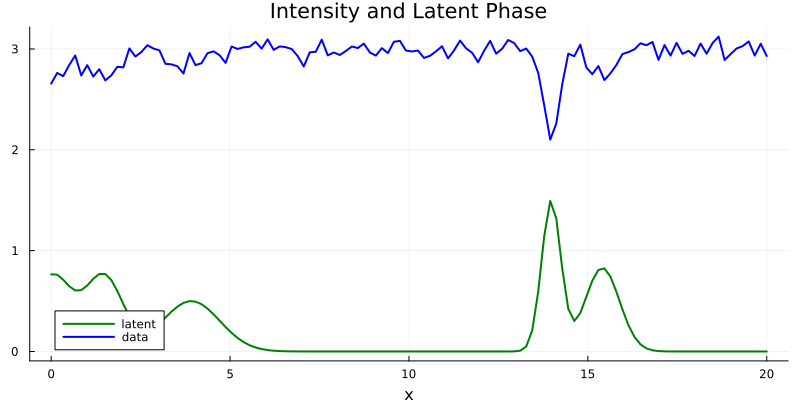

In [3]:
gaussian(x, σ) = @. exp(-x^2 / (2σ^2)) / (σ * sqrt(2π))
Random.seed!(1)
n = 120
N_electrons = 1_000
L = 20
ϵ = 0.01
y_latent = zeros(n)
x_train = collect(LinRange(0.0, L, n))
for i in 1:5
    x0 = rand(Uniform(0, L))
    σ = rand(truncated(Normal(0, 1), 0.1, 1))
    y_latent += gaussian(x_train.-x0, σ) #.+ ϵ * randn(n)
end
# y_latent += ϵ * randn(n)
println(size(y_latent))
println(size(x_train))



Intensity = (2 .+ cos.(y_latent)).*N_electrons
y_train = rand.(Poisson.(Intensity))

plot(x_train, y_latent, 
    label = "latent", 
    title = "Intensity and Latent Phase", 
    xlabel = "x", ylabel = "",
    markersize = 2, size = (800, 400), color = :green, linewidth = 2)
plot!(x_train, y_train./N_electrons, 
    label = "data", 
    markersize = 2, 
    color = :blue, linewidth = 2)

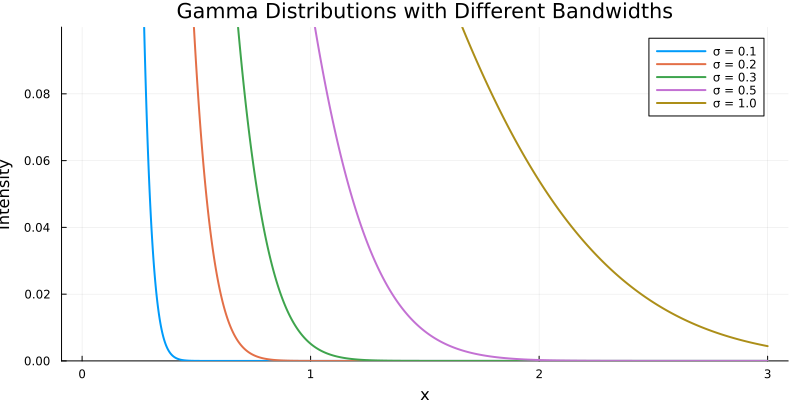

In [4]:
xs = range(0, 3, length = 10^5)
a = 1.0
Bs = [10.0^(-i) for i in 0:3]
Cs = [i for i in 1:4]
σs = [0.1, 0.2, 0.3, 0.5 , 1.0]
# cgrad = cgradient
fig1 = plot()
for σ in σs
    pdfs = pdf.(Normal(0.0,σ), xs)
    plot!(xs, pdfs, label = "σ = $σ", markersize = 2, linewidth = 2)
end
plot(fig1, 
    title = "Gamma Distributions with Different Bandwidths",
    xlabel = "x", ylabel = "Intensity",
    size = (800, 400), legend = :topright)
ylims!(0.0, 0.1)


In [5]:
using BSplines
using Pkg


spacing = 1
order = 4  # Cubic B-splines
N_knots = length(x_train[1:spacing:end])
knots_list = x_train[1:spacing:end]
basis = BSplineBasis(order, knots_list)
N_basis = length(basis)
println(N_basis)
Link(z) = π/2 * logistic(z)

122


Link (generic function with 1 method)

In [49]:
using ReverseDiff
using Turing
using Statistics: mean, median
using AdvancedHMC


@model function latent_model(y, x_input, N_poisson, λ)

    # λ_test ~ Gamma(1.0, 1e-2)
    # λ_test ~ truncated(Exponential(1.0),0.0, 5.0)
    λ_test ~ truncated(Normal(0.0, 0.01), lower = 0.0)
    weights ~ filldist(Uniform(-10.0, 10.0), length(basis))
    wrapped = @. Link($Spline(basis, weights)(x_input))
    # wrapped := @. Link($Spline(basis, weights)(x_input)) # := allows chain to track
    I = @. (2 + cos(wrapped))* N_poisson
        
    """
    the first and last point are O(h^2) accurate, 
    the interior points are O(h^2)
    """
    # @views begin
    #     n  = length(weights)
    #     d2 = similar(weights)            # will hold the second derivative at each node

    #     # --- boundaries ---------------------------------------------------------
    #     d2[1] =  weights[1] - 2*weights[2] + weights[3]                 # forward
    #     # --- interior: 5-point centred -----------------------------------------
    #     @inbounds for i in 2:n-1
    #         d2[i] = weights[i-1] - 2*weights[i] + weights[i+1]            # centred
    #     end
    #     # --- trailing boundary rows --------------------------------------------
    #     d2[n]   = weights[n-2] - 2*weights[n-1] + weights[n]            # backward
    # end
    """
    the first and last point are O(h^2) accurate, 
    the interior points are O(h^4)
    """
    @views begin
        n  = length(weights)
        d2 = similar(weights)            # will hold the second derivative at each node

        # --- boundaries ---------------------------------------------------------
        #d2[1] =  weights[1] - 2*weights[2] + weights[3]                 # forward
        d2[1] =  2*weights[1] - 5*weights[2] + 4*weights[3] - weights[4]                # forward
        d2[2] =  weights[1] - 2*weights[2] + weights[3]                 # 3-pt centred

        # --- interior: 5-point centred -----------------------------------------
        @inbounds for i in 3:n-2
            d2[i] = ( -weights[i-2] + 16*weights[i-1] -
                    30*weights[i] + 16*weights[i+1] - weights[i+2] ) / 12
        end

        # --- trailing boundary rows --------------------------------------------
        d2[n-1] = weights[n-2] - 2*weights[n-1] + weights[n]            # 3-pt centred
        d2[n]   = 2*weights[end] - 5*weights[end-1] + 4*weights[end-2] - weights[end-3]             # backward
        #d2[n]   = weights[n-2] - 2*weights[n-1] + weights[n]            # backward
    end

    Turing.@addlogprob! -inv(λ_test) * sum(abs2, d2)       # single penalty, no duplicates
    # Turing.@addlogprob! -inv(λ_test) * sum(splinevalue.(Spline(basis, weights), x_input, Derivative(2)))        # single penalty, no duplicates

    # Turing.@addlogprob! -λ* sum(abs2, d2)       # single penalty, no duplicates



    for i in eachindex(y)
        y[i] ~ Poisson(I[i])
    end
    # y ~ arraydist(Poisson.(I))
end

# λs = collect(LinRange(0.0, 1000, 10));
model = latent_model(y_train, x_train, N_electrons, 0.1)
# sampler = Turing.NUTS(max_depth=6; adtype=AutoReverseDiff(true))

n_adapts  = 1_000        # dual-averaging warm-up steps
n_samples = 3_000        # number of samples to draw after warm-up
δ_target  = 0.65         # target accept rate
ϵ0 = 0.01

D = length(basis) + 1
metric = DenseEuclideanMetric(D)
kernel = HMCKernel(Trajectory{MultinomialTS}(Leapfrog(ϵ0), GeneralisedNoUTurn(max_depth=8)))
# kernel = HMCKernel(Trajectory{MultinomialTS}(integrator, GeneralisedNoUTurn()))
mma = MassMatrixAdaptor(metric)
ssa = StepSizeAdaptor(δ_target, Leapfrog(ϵ0))
adaptor = StanHMCAdaptor(mma, ssa)  
nuts = externalsampler(AdvancedHMC.HMCSampler(kernel, metric, adaptor))
# sampler = Turing.NUTS(max_depth=8; adtype=AutoForwardDiff())
init_params = fill(-6.0, length(basis)+1)
init_params[1] = 1e-3
# chain = sample(model, nuts, n_samples; progress=true, initial_params=init_params, n_adapts=n_adapts, adtype=AutoForwardDiff())
chain = sample(model, nuts, n_samples; progress=true, initial_params=init_params, save_state=true, n_adapts=n_adapts, adtype=AutoReverseDiff(true))

Sampling   0%|                                          |  ETA: N/A
Sampling   0%|▎                                         |  ETA: 0:03:45
Sampling   1%|▍                                         |  ETA: 0:04:46
Sampling   2%|▋                                         |  ETA: 0:08:38
Sampling   2%|▉                                         |  ETA: 0:10:48
Sampling   2%|█                                         |  ETA: 0:11:51
Sampling   3%|█▎                                        |  ETA: 0:12:42
Sampling   4%|█▌                                        |  ETA: 0:13:11
Sampling   4%|█▋                                        |  ETA: 0:13:20
Sampling   4%|█▉                                        |  ETA: 0:13:20
Sampling   5%|██▏                                       |  ETA: 0:13:34
Sampling   6%|██▎                                       |  ETA: 0:13:24
Sampling   6%|██▌                                       |  ETA: 0:13:17
Sampling   6%|██▊                                       |  ETA: 0:13

Chains MCMC chain (3000×136×1 Array{Float64, 3}):

Iterations        = 1:1:3000
Number of chains  = 1
Samples per chain = 3000
Wall duration     = 500.2 seconds
Compute duration  = 500.2 seconds
parameters        = λ_test, weights[1], weights[2], weights[3], weights[4], weights[5], weights[6], weights[7], weights[8], weights[9], weights[10], weights[11], weights[12], weights[13], weights[14], weights[15], weights[16], weights[17], weights[18], weights[19], weights[20], weights[21], weights[22], weights[23], weights[24], weights[25], weights[26], weights[27], weights[28], weights[29], weights[30], weights[31], weights[32], weights[33], weights[34], weights[35], weights[36], weights[37], weights[38], weights[39], weights[40], weights[41], weights[42], weights[43], weights[44], weights[45], weights[46], weights[47], weights[48], weights[49], weights[50], weights[51], weights[52], weights[53], weights[54], weights[55], weights[56], weights[57], weights[58], weights[59], weights[60], weight

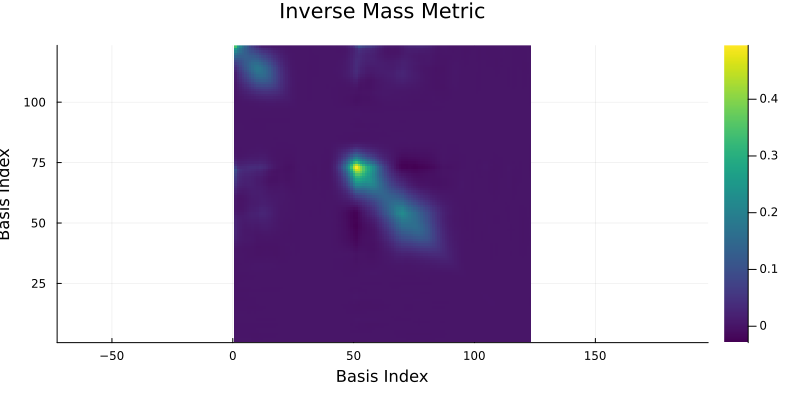

In [90]:
inv_mass_metric = chain.info.samplerstate.state.metric.M⁻¹
reordered = reverse(inv_mass_metric, dims=2)
heatmap(log1p.(0.4.*(reordered)), 
    title = "Inverse Mass Metric", 
    xlabel = "Basis Index", ylabel = "Basis Index", aspect_ratio =:equal,
    size = (800, 400), colorbar = true, c=:viridis, 
    xticks=(1:10:D, 1:10:D),
yticks=(1:10:D, 1:10:D),
xlims=(0.5, D+0.5),
ylims=(0.5, D+0.5))

heatmap(log1p.(0.4.*(reordered)), 
    title = "Inverse Mass Metric", 
    xlabel = "Basis Index", ylabel = "Basis Index", aspect_ratio =:equal,
    size = (800, 400), colorbar = true, c=:viridis)

In [14]:
chain2 = sample(model, nuts, n_samples; progress=true, initial_params=init_params, n_adapts=n_adapts, adtype=AutoReverseDiff(true))

Sampling   0%|                                          |  ETA: N/A
Sampling   0%|▎                                         |  ETA: 0:00:57
Sampling   1%|▍                                         |  ETA: 0:02:59
Sampling   2%|▋                                         |  ETA: 0:05:38
Sampling   2%|▉                                         |  ETA: 0:07:38
Sampling   2%|█                                         |  ETA: 0:08:59
Sampling   3%|█▎                                        |  ETA: 0:09:51
Sampling   4%|█▌                                        |  ETA: 0:10:28
Sampling   4%|█▋                                        |  ETA: 0:10:55
Sampling   4%|█▉                                        |  ETA: 0:11:15
Sampling   5%|██▏                                       |  ETA: 0:11:24
Sampling   6%|██▎                                       |  ETA: 0:11:38
Sampling   6%|██▌                                       |  ETA: 0:11:50
Sampling   6%|██▊                                       |  ETA: 0:11

Chains MCMC chain (3000×136×1 Array{Float64, 3}):

Iterations        = 1:1:3000
Number of chains  = 1
Samples per chain = 3000
Wall duration     = 358.8 seconds
Compute duration  = 358.8 seconds
parameters        = λ_test, weights[1], weights[2], weights[3], weights[4], weights[5], weights[6], weights[7], weights[8], weights[9], weights[10], weights[11], weights[12], weights[13], weights[14], weights[15], weights[16], weights[17], weights[18], weights[19], weights[20], weights[21], weights[22], weights[23], weights[24], weights[25], weights[26], weights[27], weights[28], weights[29], weights[30], weights[31], weights[32], weights[33], weights[34], weights[35], weights[36], weights[37], weights[38], weights[39], weights[40], weights[41], weights[42], weights[43], weights[44], weights[45], weights[46], weights[47], weights[48], weights[49], weights[50], weights[51], weights[52], weights[53], weights[54], weights[55], weights[56], weights[57], weights[58], weights[59], weights[60], weight

In [19]:
chain3 = sample(model, nuts, n_samples; progress=true, initial_params=init_params, n_adapts=n_adapts, adtype=AutoReverseDiff(false))

Sampling   0%|                                          |  ETA: N/A
Sampling   0%|▎                                         |  ETA: 0:01:59
Sampling   1%|▍                                         |  ETA: 0:04:38
Sampling   2%|▋                                         |  ETA: 0:06:17
Sampling   2%|▉                                         |  ETA: 0:08:19
Sampling   2%|█                                         |  ETA: 0:09:33
Sampling   3%|█▎                                        |  ETA: 0:10:29
Sampling   4%|█▌                                        |  ETA: 0:11:00
Sampling   4%|█▋                                        |  ETA: 0:11:25
Sampling   4%|█▉                                        |  ETA: 0:11:45
Sampling   5%|██▏                                       |  ETA: 0:12:03
Sampling   6%|██▎                                       |  ETA: 0:12:15
Sampling   6%|██▌                                       |  ETA: 0:12:25
Sampling   6%|██▊                                       |  ETA: 0:12

Chains MCMC chain (3000×136×1 Array{Float64, 3}):

Iterations        = 1:1:3000
Number of chains  = 1
Samples per chain = 3000
Wall duration     = 482.73 seconds
Compute duration  = 482.73 seconds
parameters        = λ_test, weights[1], weights[2], weights[3], weights[4], weights[5], weights[6], weights[7], weights[8], weights[9], weights[10], weights[11], weights[12], weights[13], weights[14], weights[15], weights[16], weights[17], weights[18], weights[19], weights[20], weights[21], weights[22], weights[23], weights[24], weights[25], weights[26], weights[27], weights[28], weights[29], weights[30], weights[31], weights[32], weights[33], weights[34], weights[35], weights[36], weights[37], weights[38], weights[39], weights[40], weights[41], weights[42], weights[43], weights[44], weights[45], weights[46], weights[47], weights[48], weights[49], weights[50], weights[51], weights[52], weights[53], weights[54], weights[55], weights[56], weights[57], weights[58], weights[59], weights[60], weig

In [43]:
D = length(basis) + 1
metric = DenseEuclideanMetric(D)
kernel2 = HMCKernel(Trajectory{MultinomialTS}(Leapfrog(ϵ0), ClassicNoUTurn(max_depth=8)))
# kernel = HMCKernel(Trajectory{MultinomialTS}(integrator, GeneralisedNoUTurn()))
mma = MassMatrixAdaptor(metric)
ssa = StepSizeAdaptor(δ_target, Leapfrog(ϵ0))
adaptor = StanHMCAdaptor(mma, ssa)  
nuts2 = externalsampler(AdvancedHMC.HMCSampler(kernel2, metric, adaptor))
chain3 = sample(model, nuts2, 20_000; progress=true, initial_params=init_params, n_adapts=3000, adtype=AutoReverseDiff(true))

Sampling   0%|                                          |  ETA: N/A
Sampling   0%|▎                                         |  ETA: 1:13:19
Sampling   1%|▍                                         |  ETA: 0:39:19
Sampling   2%|▋                                         |  ETA: 0:27:41
Sampling   2%|▉                                         |  ETA: 0:21:45
Sampling   2%|█                                         |  ETA: 0:18:23
Sampling   3%|█▎                                        |  ETA: 0:16:01
Sampling   4%|█▌                                        |  ETA: 0:14:18
Sampling   4%|█▋                                        |  ETA: 0:12:56
Sampling   4%|█▉                                        |  ETA: 0:11:53
Sampling   5%|██▏                                       |  ETA: 0:11:06
Sampling   6%|██▎                                       |  ETA: 0:10:22
Sampling   6%|██▌                                       |  ETA: 0:09:46
Sampling   6%|██▊                                       |  ETA: 0:09

Chains MCMC chain (20000×136×1 Array{Float64, 3}):

Iterations        = 1:1:20000
Number of chains  = 1
Samples per chain = 20000
Wall duration     = 355.3 seconds
Compute duration  = 355.3 seconds
parameters        = λ_test, weights[1], weights[2], weights[3], weights[4], weights[5], weights[6], weights[7], weights[8], weights[9], weights[10], weights[11], weights[12], weights[13], weights[14], weights[15], weights[16], weights[17], weights[18], weights[19], weights[20], weights[21], weights[22], weights[23], weights[24], weights[25], weights[26], weights[27], weights[28], weights[29], weights[30], weights[31], weights[32], weights[33], weights[34], weights[35], weights[36], weights[37], weights[38], weights[39], weights[40], weights[41], weights[42], weights[43], weights[44], weights[45], weights[46], weights[47], weights[48], weights[49], weights[50], weights[51], weights[52], weights[53], weights[54], weights[55], weights[56], weights[57], weights[58], weights[59], weights[60], wei

(3000, 136, 1)


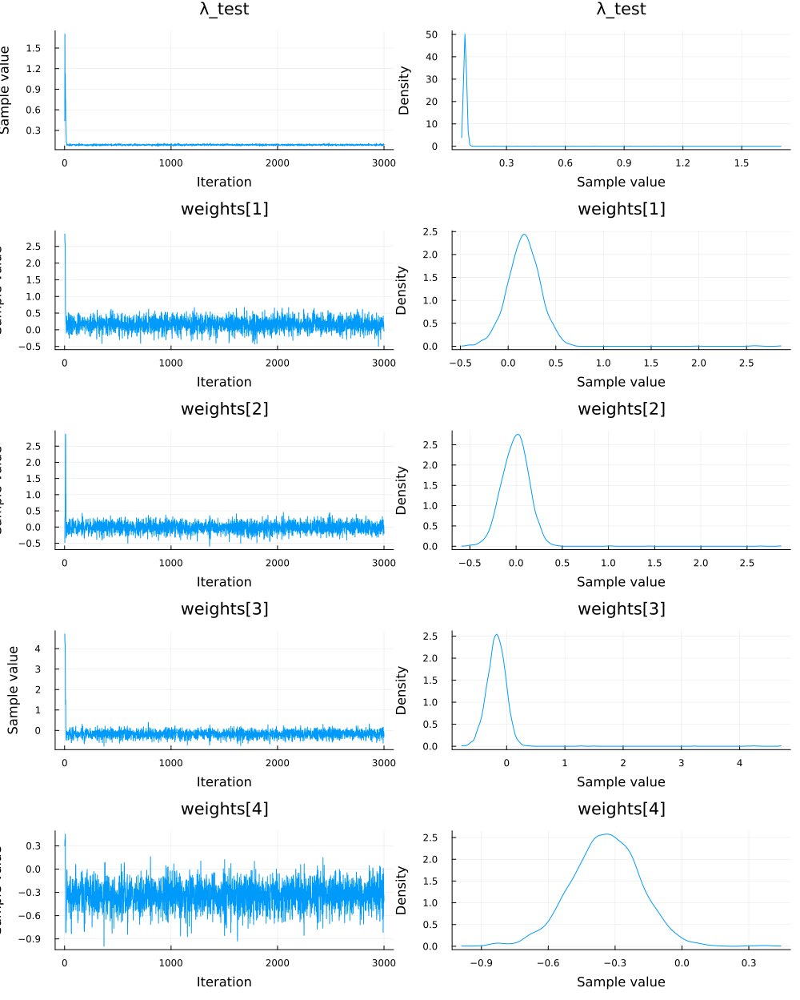

In [44]:
using StatsPlots
println(size(chain))
plot(chain[:,1:5,1])

(3000, 136, 1)


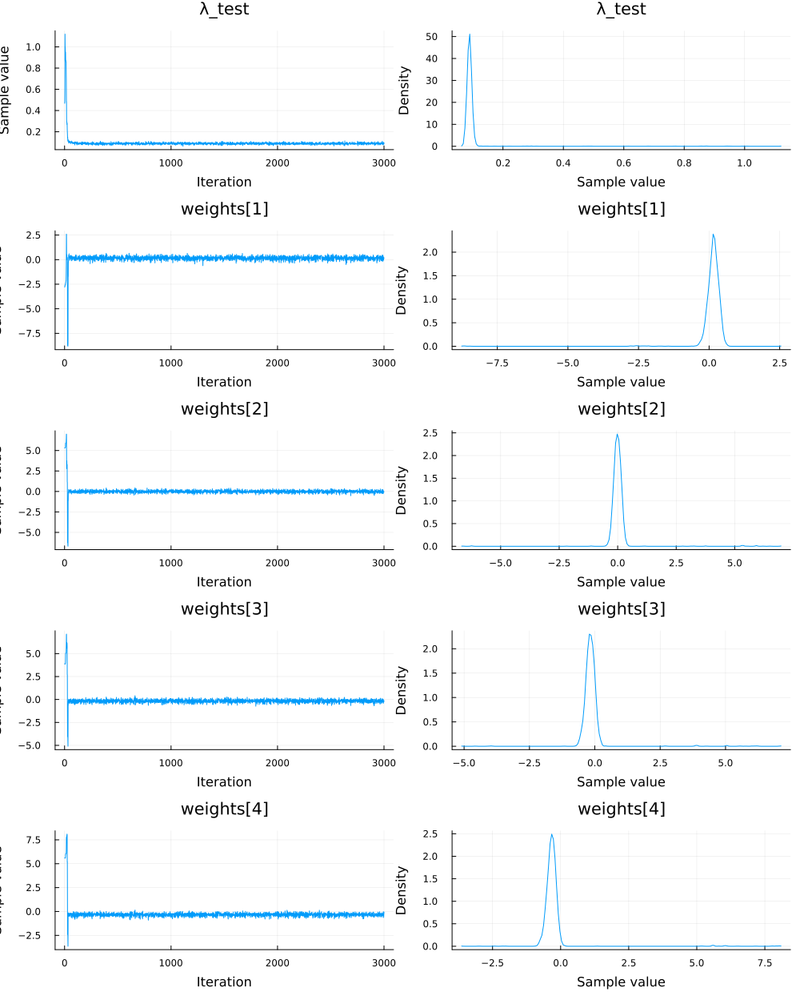

In [16]:
using StatsPlots
println(size(chain))
plot(chain2[:,1:5,1])

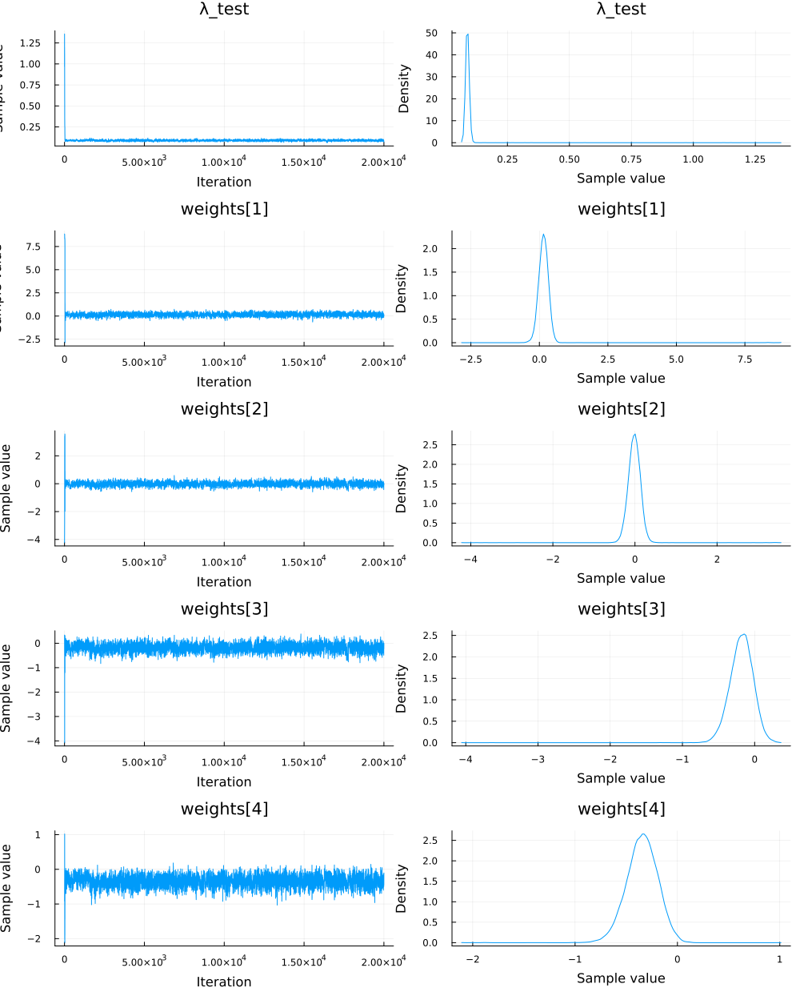

In [45]:
plot(chain3[:,1:5,1])

In [37]:
describe(chain[end÷2:end,:,:])[2]

Quantiles
   parameters      2.5%     25.0%     50.0%     75.0%     97.5% 
       Symbol   Float64   Float64   Float64   Float64   Float64 

       λ_test    0.0762    0.0841    0.0887    0.0931    0.1019
   weights[1]   -0.1783    0.0496    0.1609    0.2767    0.5060
   weights[2]   -0.2862   -0.1070   -0.0037    0.0912    0.2571
   weights[3]   -0.4995   -0.2748   -0.1730   -0.0713    0.1077
   weights[4]   -0.6611   -0.4386   -0.3374   -0.2351   -0.0513
   weights[5]   -0.8255   -0.6013   -0.4957   -0.3981   -0.2234
   weights[6]   -0.8780   -0.6684   -0.5633   -0.4581   -0.2961
   weights[7]   -0.7905   -0.5946   -0.4967   -0.3947   -0.2135
   weights[8]   -0.6731   -0.4728   -0.3783   -0.2830   -0.1103
   weights[9]   -0.5043   -0.3267   -0.2348   -0.1492    0.0165
  weights[10]   -0.3739   -0.2153   -0.1252   -0.0434    0.1070
  weights[11]   -0.3362   -0.1575   -0.0746    0.0064    0.1735
  weights[12]   -0.4459   -0.2630   -0.1697   -0.0742    0.0965
  weights[13]   -0.7375   -

In [36]:
describe(chain2[end÷2:end,:,:])[2]

Quantiles
   parameters      2.5%     25.0%     50.0%     75.0%     97.5% 
       Symbol   Float64   Float64   Float64   Float64   Float64 

       λ_test    0.0753    0.0840    0.0887    0.0936    0.1030
   weights[1]   -0.2073    0.0426    0.1598    0.2802    0.4640
   weights[2]   -0.3001   -0.1104   -0.0096    0.0963    0.2689
   weights[3]   -0.5063   -0.2802   -0.1706   -0.0608    0.1366
   weights[4]   -0.6575   -0.4269   -0.3326   -0.2242   -0.0562
   weights[5]   -0.8048   -0.5943   -0.4886   -0.3844   -0.2244
   weights[6]   -0.8646   -0.6579   -0.5625   -0.4549   -0.2751
   weights[7]   -0.8121   -0.5859   -0.4864   -0.3856   -0.2138
   weights[8]   -0.6478   -0.4621   -0.3644   -0.2772   -0.0992
   weights[9]   -0.5128   -0.3282   -0.2363   -0.1453    0.0062
  weights[10]   -0.3847   -0.2169   -0.1291   -0.0381    0.1172
  weights[11]   -0.3557   -0.1736   -0.0820    0.0054    0.1714
  weights[12]   -0.4810   -0.2798   -0.1768   -0.0785    0.0892
  weights[13]   -0.7660   -

In [39]:
describe(chain3[end÷2:end,:,:])[2]

Quantiles
   parameters      2.5%     25.0%     50.0%     75.0%     97.5% 
       Symbol   Float64   Float64   Float64   Float64   Float64 

       λ_test    0.0723    0.0821    0.0862    0.0908    0.0994
   weights[1]   -0.1916    0.0314    0.1331    0.2332    0.4243
   weights[2]   -0.3365   -0.1356   -0.0335    0.0584    0.1948
   weights[3]   -0.5234   -0.3089   -0.2020   -0.0994    0.0516
   weights[4]   -0.6377   -0.4554   -0.3440   -0.2476   -0.0750
   weights[5]   -0.7595   -0.5747   -0.4909   -0.3940   -0.2077
   weights[6]   -0.8188   -0.6260   -0.5419   -0.4538   -0.2921
   weights[7]   -0.7463   -0.5607   -0.4699   -0.3810   -0.2154
   weights[8]   -0.6331   -0.4615   -0.3694   -0.2746   -0.1029
   weights[9]   -0.5043   -0.3327   -0.2413   -0.1549    0.0147
  weights[10]   -0.4108   -0.2372   -0.1456   -0.0583    0.1137
  weights[11]   -0.3559   -0.1840   -0.0974   -0.0122    0.1358
  weights[12]   -0.4837   -0.2893   -0.1903   -0.0949    0.0702
  weights[13]   -0.7784   -

In [12]:
fig1 = plot(x_train, y_latent, 
        # label = "λ = $(λs[1])", 
        markersize = 2, color = :black, linewidth = 3)
fig2 = plot()
n_spacing = 50
phis_reconstructed = Matrix{Float64}(undef, length(2000:n_spacing:3000), length(x_train))
weights_reconstructed = Matrix{Float64}(undef, length(2000:n_spacing:3000), length(basis))
Intensities_reconstructed = Matrix{Float64}(undef, length(2000:n_spacing:3000), length(x_train))
for (k,k_val) in enumerate(2000:n_spacing:3000)
    weight_values = [chain[k_val, Symbol("weights[$i]"), 1] for i in 1:length(basis)]
    reconstructed_spline = Spline(basis, weight_values)
    phi_reconstructed = @. Link(reconstructed_spline(x_train))
    Int_reconstructed = @. (2 + cos(phi_reconstructed))*N_electrons
    Int_reconstructed = rand.(Poisson.(Int_reconstructed))

    # phi_reconstructed = [chain[k_val, Symbol("wrapped[$i]"), 1] for i in 1:length(x_train)]
    phis_reconstructed[k, :] = phi_reconstructed
    weights_reconstructed[k, :] = weight_values
    Intensities_reconstructed[k, :] = Int_reconstructed
    

    # println(length(weight_values[1:end-2]))
    # println(length(x_train[1:spacing:end]))
    @assert length(weight_values[1:end-2]) == length(x_train[1:spacing:end])

    plot!(fig1, x_train, phi_reconstructed, 
        title = "Posterior samples of weights", 
        xlabel = "", ylabel = "", 
        markersize = 2, color = :green, linewidth = 1, alpha =0.05)
    plot!(fig1, x_train, Int_reconstructed./N_electrons,
        title = "Posterior samples of weights", 
        xlabel = "", ylabel = "", 
        markersize = 2, color = :blue, linewidth = 1, alpha =0.05)

    plot!(fig2, x_train[1:spacing:end], weight_values[1:end-2], 
        title = "Posterior samples of weights", 
        xlabel = "", ylabel = "", 
        markersize = 2, color = :blue, linewidth = 1, alpha =0.1)

end
# plot!(legend=false)
println(size(phis_reconstructed))
phi_mean  = median(phis_reconstructed, dims = 1) |> vec               # N-vector
phi_mean  = mapslices(p -> quantile(p, 0.50), phis_reconstructed; dims = 1) |> vec
phi_low   = mapslices(p -> quantile(p, 0.15), phis_reconstructed; dims = 1) |> vec
phi_high  = mapslices(p -> quantile(p, 0.85), phis_reconstructed; dims = 1) |> vec
w_mean  = median(weights_reconstructed, dims = 1) |> vec               # N-vector
w_mean   = mapslices(p -> quantile(p, 0.50), weights_reconstructed; dims = 1) |> vec
w_low   = mapslices(p -> quantile(p, 0.15), weights_reconstructed; dims = 1) |> vec
w_high  = mapslices(p -> quantile(p, 0.85), weights_reconstructed; dims = 1) |> vec
# println(logjoint(model, chain[end, :, 1]))
int_mean  = median(Intensities_reconstructed, dims = 1) |> vec               # N-vector
int_mean  = mapslices(p -> quantile(p, 0.50), Intensities_reconstructed; dims = 1) |> vec
int_low   = mapslices(p -> quantile(p, 0.15), Intensities_reconstructed; dims = 1) |> vec
int_high  = mapslices(p -> quantile(p, 0.85), Intensities_reconstructed; dims = 1) |> vec
int_mean = int_mean ./ N_electrons
int_low = int_low ./ N_electrons
int_high = int_high ./ N_electrons

# logjoint_min = findminimum(logjoint(model, chain[:, :, 1]))

# println(log_prob = Turing.logpdf(model, vcat(0.02, w_mean)))

plot!(fig1, x_train, (phi_mean);
    ribbon = (phi_mean .- phi_low, phi_high .- phi_mean),   # symmetric ribbon
    label  = "posterior mean",
    title = "Phase reconstructed",  # Added comma here
    xlabel = "x", ylabel = "f(x)",
    legend = :topleft, lw = 3, color=:green);
plot!(fig1, x_train, (int_mean);
    ribbon = (int_mean .- int_low, int_high .- int_mean),   # symmetric ribbon
    label  = "posterior mean",
    title = "Intensity reconstructed",  # Added comma here
    xlabel = "x", ylabel = "f(x)",
    legend = :topleft, lw = 3, color=:blue);
plot!(fig1, x_train, y_train./N_electrons,
    label = "data", 
    markersize = 2, 
    color = :blue, linewidth = 2)
plot!(fig2, x_train[1:spacing:end], (w_mean[1:end-2]);
    ribbon = (w_mean[1:end-2] .- w_low[1:end-2], w_high[1:end-2] .- w_mean[1:end-2]),   # symmetric ribbon
    label  = "posterior mean",
    xlabel = "x", ylabel = "f(x)",
    legend = :topleft, lw = 4);




(21, 120)


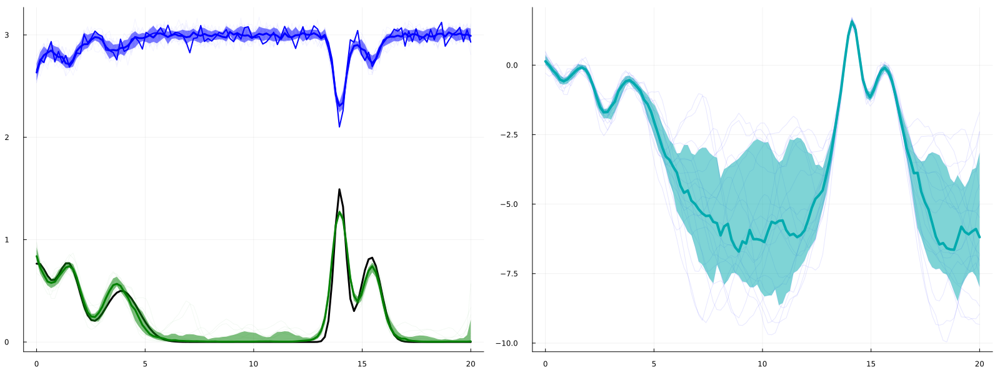

In [13]:
plot(fig1, fig2, layout = (1, 2), size = (1600, 600), 
    title = "", 
    xlabel = "x", ylabel = "", 
    label = ["latent" "weights"], legend = false)


In [48]:
methods(quantile)

# 79 methods for generic function "quantile" from Statistics:
  [1] quantile(Ω::Soliton, v::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/discrete/soliton.jl:119
  [2] quantile(d::Hypergeometric, q::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariates.jl:652
  [3] quantile(d::Chernoff, tau::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/continuous/chernoff.jl:158
  [4] quantile(d::Kolmogorov, p::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/quantilealgs.jl:146
  [5] quantile(d::DiscreteUniform, p::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/discrete/discreteuniform.jl:90
  [6] quantile(d::BetaPrime, p::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/continuous/betaprime.jl:110
  [7] quantile(d::Gumbel, p::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/continuous/gumbel.jl:105
  [8] quantile(d::Laplace, p::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/continuous/laplace.jl:94
  [9] quantile(d::Exponential, p::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/continuous/exponential.jl:92
 [10] quantile(d::Distributions.AffineDistribution, q::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/locationscale.jl:165
 [11] quantile(d::NoncentralHypergeometric{T}, q::Real) where T<:Real
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/discrete/noncentralhypergeometric.jl:12
 [12] quantile(d::Epanechnikov, p::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/quantilealgs.jl:146
 [13] quantile(d::JohnsonSU, q::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/continuous/johnsonsu.jl:86
 [14] quantile(d::Binomial, q::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariates.jl:652
 [15] quantile(d::Chi, p::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/continuous/chi.jl:106
 [16] quantile(d::Levy, p::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/continuous/levy.jl:91
 [17] quantile(d::NoncentralT, q::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariates.jl:652
 [18] quantile(d::SkewedExponentialPower, p::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/continuous/skewedexponentialpower.jl:111
 [19] quantile(d::Gamma, q::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariates.jl:652
 [20] quantile(d::Normal, q::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariates.jl:652
 [21] quantile(d::Kumaraswamy, q::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/continuous/kumaraswamy.jl:75
 [22] quantile(d::EdgeworthZ, p::Float64)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/edgeworth.jl:60
 [23] quantile(d::Distributions.EdgeworthAbstract, p::Float64)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/edgeworth.jl:120
 [24] quantile(d::Erlang, q::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariates.jl:652
 [25] quantile(d::FDist, q::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariates.jl:652
 [26] quantile(d::NoncentralBeta, q::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariates.jl:652
 [27] quantile(d::LogNormal, q::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/continuous/lognormal.jl:142
 [28] quantile(d::Lindley, q::Real)
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/continuous/lindley.jl:132
 [29] quantile(d::Dirac{T}, p::Real) where T
     @ Distributions ~/.julia/packages/Distributions/YQSrn/src/univariate/discrete/dirac.jl:50
 [30] quantile(d::StudentizedRange,

In [17]:
fig1 = plot(x_train, y_latent, 
        # label = "λ = $(λs[1])", 
        markersize = 2, color = :black, linewidth = 3)
fig2 = plot()
n_spacing = 50
phis_reconstructed = Matrix{Float64}(undef, length(2000:n_spacing:3000), length(x_train))
weights_reconstructed = Matrix{Float64}(undef, length(2000:n_spacing:3000), length(basis))
Intensities_reconstructed = Matrix{Float64}(undef, length(2000:n_spacing:3000), length(x_train))
for (k,k_val) in enumerate(2000:n_spacing:3000)
    weight_values = [chain2[k_val, Symbol("weights[$i]"), 1] for i in 1:length(basis)]
    reconstructed_spline = Spline(basis, weight_values)
    phi_reconstructed = @. Link(reconstructed_spline(x_train))
    Int_reconstructed = @. (2 + cos(phi_reconstructed))*N_electrons
    Int_reconstructed = rand.(Poisson.(Int_reconstructed))

    # phi_reconstructed = [chain[k_val, Symbol("wrapped[$i]"), 1] for i in 1:length(x_train)]
    phis_reconstructed[k, :] = phi_reconstructed
    weights_reconstructed[k, :] = weight_values
    Intensities_reconstructed[k, :] = Int_reconstructed
    

    # println(length(weight_values[1:end-2]))
    # println(length(x_train[1:spacing:end]))
    @assert length(weight_values[1:end-2]) == length(x_train[1:spacing:end])

    plot!(fig1, x_train, phi_reconstructed, 
        title = "Posterior samples of weights", 
        xlabel = "", ylabel = "", 
        markersize = 2, color = :green, linewidth = 1, alpha =0.05)
    plot!(fig1, x_train, Int_reconstructed./N_electrons,
        title = "Posterior samples of weights", 
        xlabel = "", ylabel = "", 
        markersize = 2, color = :blue, linewidth = 1, alpha =0.05)

    plot!(fig2, x_train[1:spacing:end], weight_values[1:end-2], 
        title = "Posterior samples of weights", 
        xlabel = "", ylabel = "", 
        markersize = 2, color = :blue, linewidth = 1, alpha =0.1)

end
# plot!(legend=false)
println(size(phis_reconstructed))
phi_mean  = median(phis_reconstructed, dims = 1) |> vec               # N-vector
phi_mean  = mapslices(p -> quantile(p, 0.50), phis_reconstructed; dims = 1) |> vec
phi_low   = mapslices(p -> quantile(p, 0.15), phis_reconstructed; dims = 1) |> vec
phi_high  = mapslices(p -> quantile(p, 0.85), phis_reconstructed; dims = 1) |> vec
w_mean  = median(weights_reconstructed, dims = 1) |> vec               # N-vector
w_mean   = mapslices(p -> quantile(p, 0.50), weights_reconstructed; dims = 1) |> vec
w_low   = mapslices(p -> quantile(p, 0.15), weights_reconstructed; dims = 1) |> vec
w_high  = mapslices(p -> quantile(p, 0.85), weights_reconstructed; dims = 1) |> vec
# println(logjoint(model, chain[end, :, 1]))
int_mean  = median(Intensities_reconstructed, dims = 1) |> vec               # N-vector
int_mean  = mapslices(p -> quantile(p, 0.50), Intensities_reconstructed; dims = 1) |> vec
int_low   = mapslices(p -> quantile(p, 0.15), Intensities_reconstructed; dims = 1) |> vec
int_high  = mapslices(p -> quantile(p, 0.85), Intensities_reconstructed; dims = 1) |> vec
int_mean = int_mean ./ N_electrons
int_low = int_low ./ N_electrons
int_high = int_high ./ N_electrons

# logjoint_min = findminimum(logjoint(model, chain[:, :, 1]))

# println(log_prob = Turing.logpdf(model, vcat(0.02, w_mean)))

plot!(fig1, x_train, (phi_mean);
    ribbon = (phi_mean .- phi_low, phi_high .- phi_mean),   # symmetric ribbon
    label  = "posterior mean",
    title = "Phase reconstructed",  # Added comma here
    xlabel = "x", ylabel = "f(x)",
    legend = :topleft, lw = 3, color=:green);
plot!(fig1, x_train, (int_mean);
    ribbon = (int_mean .- int_low, int_high .- int_mean),   # symmetric ribbon
    label  = "posterior mean",
    title = "Intensity reconstructed",  # Added comma here
    xlabel = "x", ylabel = "f(x)",
    legend = :topleft, lw = 3, color=:blue);
plot!(fig1, x_train, y_train./N_electrons,
    label = "data", 
    markersize = 2, 
    color = :blue, linewidth = 2)
plot!(fig2, x_train[1:spacing:end], (w_mean[1:end-2]);
    ribbon = (w_mean[1:end-2] .- w_low[1:end-2], w_high[1:end-2] .- w_mean[1:end-2]),   # symmetric ribbon
    label  = "posterior mean",
    xlabel = "x", ylabel = "f(x)",
    legend = :topleft, lw = 4);




(21, 120)


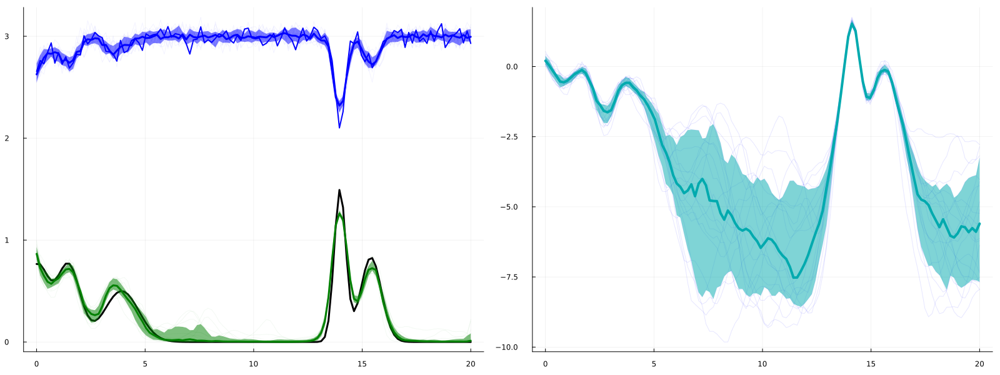

In [18]:
plot(fig1, fig2, layout = (1, 2), size = (1600, 600), 
    title = "", 
    xlabel = "x", ylabel = "", 
    label = ["latent" "weights"], legend = false)


In [46]:
fig1 = plot(x_train, y_latent, 
        # label = "λ = $(λs[1])", 
        markersize = 2, color = :black, linewidth = 3)
fig2 = plot()
n_spacing = 50
phis_reconstructed = Matrix{Float64}(undef, length(2000:n_spacing:3000), length(x_train))
weights_reconstructed = Matrix{Float64}(undef, length(2000:n_spacing:3000), length(basis))
Intensities_reconstructed = Matrix{Float64}(undef, length(2000:n_spacing:3000), length(x_train))
for (k,k_val) in enumerate(2000:n_spacing:3000)
    weight_values = [chain3[k_val, Symbol("weights[$i]"), 1] for i in 1:length(basis)]
    reconstructed_spline = Spline(basis, weight_values)
    phi_reconstructed = @. Link(reconstructed_spline(x_train))
    Int_reconstructed = @. (2 + cos(phi_reconstructed))*N_electrons
    Int_reconstructed = rand.(Poisson.(Int_reconstructed))

    # phi_reconstructed = [chain[k_val, Symbol("wrapped[$i]"), 1] for i in 1:length(x_train)]
    phis_reconstructed[k, :] = phi_reconstructed
    weights_reconstructed[k, :] = weight_values
    Intensities_reconstructed[k, :] = Int_reconstructed
    

    # println(length(weight_values[1:end-2]))
    # println(length(x_train[1:spacing:end]))
    @assert length(weight_values[1:end-2]) == length(x_train[1:spacing:end])

    plot!(fig1, x_train, phi_reconstructed, 
        title = "Posterior samples of weights", 
        xlabel = "", ylabel = "", 
        markersize = 2, color = :green, linewidth = 1, alpha =0.05)
    plot!(fig1, x_train, Int_reconstructed./N_electrons,
        title = "Posterior samples of weights", 
        xlabel = "", ylabel = "", 
        markersize = 2, color = :blue, linewidth = 1, alpha =0.05)

    plot!(fig2, x_train[1:spacing:end], weight_values[1:end-2], 
        title = "Posterior samples of weights", 
        xlabel = "", ylabel = "", 
        markersize = 2, color = :blue, linewidth = 1, alpha =0.1)

end
# plot!(legend=false)
println(size(phis_reconstructed))
phi_mean  = median(phis_reconstructed, dims = 1) |> vec               # N-vector
phi_mean  = mapslices(p -> quantile(p, 0.50), phis_reconstructed; dims = 1) |> vec
phi_low   = mapslices(p -> quantile(p, 0.15), phis_reconstructed; dims = 1) |> vec
phi_high  = mapslices(p -> quantile(p, 0.85), phis_reconstructed; dims = 1) |> vec
w_mean  = median(weights_reconstructed, dims = 1) |> vec               # N-vector
w_mean   = mapslices(p -> quantile(p, 0.50), weights_reconstructed; dims = 1) |> vec
w_low   = mapslices(p -> quantile(p, 0.15), weights_reconstructed; dims = 1) |> vec
w_high  = mapslices(p -> quantile(p, 0.85), weights_reconstructed; dims = 1) |> vec
# println(logjoint(model, chain[end, :, 1]))
int_mean  = median(Intensities_reconstructed, dims = 1) |> vec               # N-vector
int_mean  = mapslices(p -> quantile(p, 0.50), Intensities_reconstructed; dims = 1) |> vec
int_low   = mapslices(p -> quantile(p, 0.15), Intensities_reconstructed; dims = 1) |> vec
int_high  = mapslices(p -> quantile(p, 0.85), Intensities_reconstructed; dims = 1) |> vec
int_mean = int_mean ./ N_electrons
int_low = int_low ./ N_electrons
int_high = int_high ./ N_electrons

# logjoint_min = findminimum(logjoint(model, chain[:, :, 1]))

# println(log_prob = Turing.logpdf(model, vcat(0.02, w_mean)))

plot!(fig1, x_train, (phi_mean);
    ribbon = (phi_mean .- phi_low, phi_high .- phi_mean),   # symmetric ribbon
    label  = "posterior mean",
    title = "Phase reconstructed",  # Added comma here
    xlabel = "x", ylabel = "f(x)",
    legend = :topleft, lw = 3, color=:green);
plot!(fig1, x_train, (int_mean);
    ribbon = (int_mean .- int_low, int_high .- int_mean),   # symmetric ribbon
    label  = "posterior mean",
    title = "Intensity reconstructed",  # Added comma here
    xlabel = "x", ylabel = "f(x)",
    legend = :topleft, lw = 3, color=:blue);
plot!(fig1, x_train, y_train./N_electrons,
    label = "data", 
    markersize = 2, 
    color = :blue, linewidth = 2)
plot!(fig2, x_train[1:spacing:end], (w_mean[1:end-2]);
    ribbon = (w_mean[1:end-2] .- w_low[1:end-2], w_high[1:end-2] .- w_mean[1:end-2]),   # symmetric ribbon
    label  = "posterior mean",
    xlabel = "x", ylabel = "f(x)",
    legend = :topleft, lw = 4);




(21, 120)


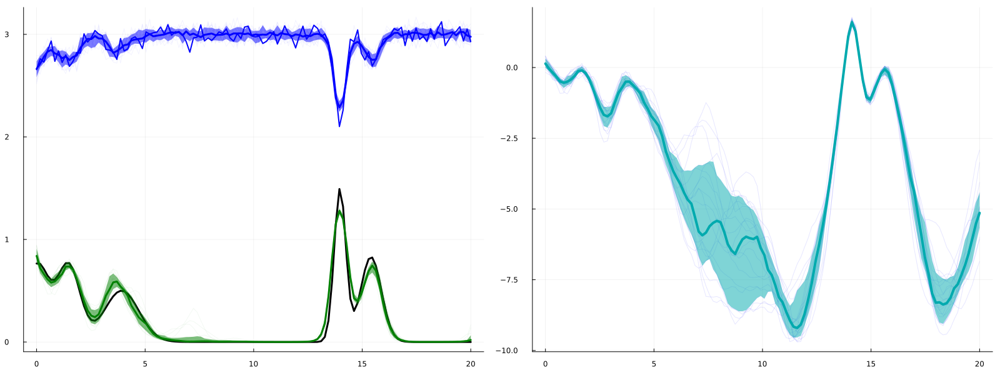

In [47]:
plot(fig1, fig2, layout = (1, 2), size = (1600, 600), 
    title = "", 
    xlabel = "x", ylabel = "", 
    label = ["latent" "weights"], legend = false)


In [ ]:
using ArviZ
n_samples = 2000
function calculating_loos_and_waics(λ)
    
    # idata_turing_post = from_mcmcchains(
    #     chain;
    #     coords = Dict(
    #         "chain" => 1:size(chain, 1),
    #         "draw"  => 1:size(chain, 2),
    #         "sample" => 1:size(chain, 3)
    #     ),
    #     dims = Dict(
    #         "chain" => 1,
    #         "draw"  => 2,
    #         "sample" => 3
    #     ),
    #     library = "Turing"
    # )
    model = latent_model(y_train, x_train, N_electrons, λ)
    prior = sample(model, Prior(), n_samples; progress=false)
    chain = sample(model, sampler, n_samples; progress=false)
    # prior = sample(model, Prior(), n_samples; progress=false)
    model_predict = latent_model(similar(y_train, Missing), x_train, N_electrons, λ)
    
    prior_predictive = predict(model_predict, prior)
    posterior_predictive = predict(model_predict, chain)

    # loglikelihoods = Turing.pointwise_loglikelihoods(
    #     model, MCMCChains.get_sections(chain, :parameters)
    # )
    log_likelihood = let
        log_likelihood = Turing.pointwise_loglikelihoods(
            model, MCMCChains.get_sections(chain, :parameters)
        )
        # Ensure the ordering of the loglikelihoods matches the ordering of `posterior_predictive`
        ynames = string.(keys(posterior_predictive))
        log_likelihood_y = getindex.(Ref(log_likelihood), ynames)
        (; y=cat(log_likelihood_y...; dims=3))
    end;

    eltypes = Dict("y" => Int64)  
    idata = from_mcmcchains(
        chain;
        posterior_predictive,
        log_likelihood,
        prior,
        prior_predictive,
        observed_data=(;y_train),
        library = "Turing",
        eltypes = eltypes,
    );
    # return ArviZ.loo(idata).estimates[1], ArviZ.waic(idata).estimates[1]
    return  [ArviZ.loo(idata).estimates[i] for i in 1:4], [ArviZ.waic(idata).estimates[i] for i in 1:4]
end
using ProgressBars
λs = collect(range(0.0, 0.75, 40))
loos = Matrix{Float64}(undef,4, length(λs))
waics = Matrix{Float64}(undef, 4, length(λs))
Threads.@threads for i in eachindex(λs)
# for (i, λ) in enumerate(ProgressBar(λs))
    loos[:,i], waics[:,i] = calculating_loos_and_waics(λs[i]);
end

In [ ]:
# plot(λs, [loos waics], 
#     label = ["LOO" "WAIC"],
#     title = "LOO and WAIC", 
#     xlabel = "λ", ylabel = "Score",
#     markersize = 4, size = (800, 400), 
#     color = [:blue :red], 
#     linewidth = 2,
#     markers = true)
max_val, max_idx = findmax(loos[1,:])
println(λs[max_idx])
max_val, max_idx = findmax(waics[1,:])
println(λs[max_idx])
plot(λs, loos[1,:], 
    ribbon=loos[2,:],
    label = "LOO",
    title = "Model Comparison Metrics", 
    xlabel = "λ", ylabel = "ELPD (higher is better)",
    markersize = 4, size = (800, 400), 
    color = :blue, 
    linewidth = 2,
    markers = true)

plot!(λs, waics[1,:], 
    ribbon=waics[2,:],
    label = "WAIC",
    color = :red, 
    linewidth = 2,
    markers = true)


In [ ]:
scatter(λs)
scatter!([8],[λs[8]])

In [ ]:
ArviZ.loo(idata) # higher ELPD is better
propertynames(ArviZ.waic(idata))
test = [ArviZ.waic(idata).estimates[i] for i in 1:4] # lower ELPD is better
# ArviZ.waic(idata).estimates[1]
# println(test)

In [ ]:
propertynames(ArviZ.loo(idata)) # higher ELPD is better
# ArviZ.loo(idata).psis_result
ArviZ.loo(idata).estimates # lower ELPD is better
# ArviZ.loo(idata).pointwise

In [ ]:
# ENV["PYTHON"] = "/home/nicolas/anaconda3/bin/python"

using Pkg
# Pkg.add("InferenceObjects")
# Pkg.add("MCMCDiagnosticTools")
# Pkg.add("PSIS")
# using InferenceObjects
# using MCMCDiagnosticTools
# using PSIS
# using PosteriorStats
using ArviZ
# Pkg.build("PyCall")
# using PythonCall
# using PyCall
# using ArviZ

In [ ]:
plot_autocorr(chain)

In [ ]:
x_range = 0:0.01:1
# plot(x_range, pdf.(LogNormal(1.0, 1.0), x_range),
#     label = "LogNormal(0.0, 1.0)",
#     title = "LogNormal Distribution",
#     xlabel = "x", ylabel = "Density", size = (800, 400), 
#     color = :blue, 
#     linewidth = 2)
plot(x_range, pdf.(InverseGamma(1.0, 0.0005), x_range),
    label = "InverseGamma(1.0, 1.0)",
    color = :red, 
    linewidth = 2)
# plot!(x_range, pdf.(Gamma(0.01, 0.01), x_range),
#     label = "Gamma(1.0, 1.0)",
#     color = :green, 
#     linewidth = 2)

In [ ]:
using ReverseDiff
using Turing
using Statistics: mean, median
@model function latent_model(y, x_input, N_poisson)
    #λ ~ LogNormal(1.0, 1.0) 
    λ ~ Gamma(1.0, 0.005) 

    # λ ~ InverseGamma(1, 1)
    # λ_test ~ Weibull(1.0, 0.01) 
    weights ~ filldist(Uniform(-10.0, 10.0), length(basis))
    wrapped = @. Link($Spline(basis, weights)(x_input))
    # wrapped := @. Link($Spline(basis, weights)(x_input)) # := allows chain to track

    I = @. (2 + cos(wrapped))* N_poisson
    
    
    """
    the first and last point are O(h^2) accurate, 
    the interior points are O(h^4)
    """
    @views begin
        n  = length(weights)
        d2 = similar(weights)            # will hold the second derivative at each node

        # --- boundaries ---------------------------------------------------------
        #d2[1] =  weights[1] - 2*weights[2] + weights[3]                 # forward
        d2[1] =  2*weights[1] - 5*weights[2] + 4*weights[3] - weights[4]                # forward
        d2[2] =  weights[1] - 2*weights[2] + weights[3]                 # 3-pt centred

        # --- interior: 5-point centred -----------------------------------------
        @inbounds for i in 3:n-2
            d2[i] = ( -weights[i-2] + 16*weights[i-1] -
                    30*weights[i] + 16*weights[i+1] - weights[i+2] ) / 12
        end

        # --- trailing boundary rows --------------------------------------------
        d2[n-1] = weights[n-2] - 2*weights[n-1] + weights[n]            # 3-pt centred
        d2[n]   = 2*weights[end] - 5*weights[end-1] + 4*weights[end-2] - weights[end-3]             # backward
    #   d2[n]   = weights[n-2] - 2*weights[n-1] + weights[n]            # backward
    end

    Turing.@addlogprob! -inv(λ) * sum(abs2, d2)       # single penalty, no duplicates


    for i in eachindex(y)
        y[i] ~ Poisson(I[i])
    end
    # y ~ arraydist(Poisson.(I))
end

# λs = collect(LinRange(0.0, 1000, 10));
model = latent_model(y_train, x_train, N_electrons)
sampler = Turing.NUTS(max_depth=6; adtype=AutoReverseDiff(true))
# sampler = Turing.NUTS(max_depth=8; adtype=AutoForwardDiff())

chain = sample(model, sampler, 2000; progress=true)

In [ ]:
using StatsPlots
plot(chain[:,1:5,1])

In [ ]:
using ParetoSmooth

In [ ]:
propertynames(psis_loo(model,chain))

In [ ]:
psis_loo(model,chain)

In [ ]:
function psis_func(model,chain)
    return psis_loo(model, chain)
end

In [ ]:
results = psis_func(model, chain);
results.estimates


In [ ]:
results.estimates


In [ ]:
color_gradient = cgrad(:viridis, length(λs), categorical=true)
fig1 = plot()
for (i,lambda_val) in enumerate(λs)
    plot!(x_train[1:spacing:end], weights_samples[i, 1:end-1],
        title = "Latent Phase", 
        xlabel = "λ", 
        ylabel = "latent phase",
        label = "λ = $(round(lambda_val, digits=2))",
        markersize = 2, 
        size = (800, 400),
        color = color_gradient[i],
        linewidth = 2)
end
display(fig1)

In [ ]:
lp = copy(latent_phis);

In [ ]:
# fig1 = plot() 
color_gradient = cgrad(:viridis, length(λs), categorical=true)

# for (i, lambda_val) in enumerate(λs)
#     plot!(x_train, latent_phis[i, :],
#           label = "λ = $(round(lambda_val, digits=2))",
#           markersize = 2, color = :blue, linewidth = 2)
# end
fig1 = plot(title="Spline Results for Different λ Values", 
            xlabel="x", ylabel="Phase", 
            size=(800, 500))
# latent_phis = abs.(latent_phis)
for (i, lambda_val) in enumerate(λs[1:end])
      i == 8 ? continue :
      plot!(x_train, latent_phis[i, :],
          label = "λ = $(round(lambda_val, digits=2))",
          markersize = 2, 
          color = color_gradient[i],  # Use color from gradient
          linewidth = 2, alpha=0.5)
end
plot!(x_train, y_latent,
      label = "latent",
      markersize = 2, 
      color = :red, linewidth = 2)
# plot!(legend = false)
# plot!(x_train, phis_recovered[1, :],
#           label = "",
#           markersize = 2, 
#           color =:black,  # Use color from gradient
#           linewidth = 3, linestyle = :dash)
display(fig1)



In [ ]:
fig2 = plot(title="Spline Results for Different λ Values", 
            xlabel="x", ylabel="Phase", 
            size=(800, 500))
phi_diff = diff(latent_phis[1, :])
phi_d_scale = maximum(phi_diff) 
phi_λ_diff = Matrix{Float64}(undef, length(λs), length(x_train)-1)


for (i, lambda_val) in enumerate(λs)
      phi_diff = diff(latent_phis[i, :])
      phi_diff = phi_diff ./ maximum(phi_diff) * phi_d_scale
      phi_λ_diff[i, :] = phi_diff
      plot!(x_train[1:end-1], phi_diff,
          label = "λ = $(round(lambda_val, digits=2))",
          markersize = 2, 
          color = color_gradient[i],  # Use color from gradient
          linewidth = 2)
end
plot!(x_train[1:end-1], diff(y_latent),
      label = "latent",
      markersize = 2, 
      color = :red, linewidth = 2)
plot!(legend = false)
display(fig2)

In [ ]:
fig3 = plot(title="Spline Results for Different λ Values", 
            xlabel="x", ylabel="Phase", 
            size=(800, 500))
phi_diff = diff(diff(latent_phis[1, :]))
phi_d_scale = maximum(phi_diff) 
phi_λ_diff2 = Matrix{Float64}(undef, length(λs), length(x_train)-2)


for (i, lambda_val) in enumerate(λs)
    phi_diff = diff(diff(latent_phis[i, :]))
    phi_diff = phi_diff ./ maximum(phi_diff) 
    phi_λ_diff2[i, :] = phi_diff
    plot!(x_train[1:end-2], phi_diff,
          label = "λ = $(round(lambda_val, digits=2))",
          markersize = 2, 
          color = color_gradient[i],  # Use color from gradient
          linewidth = 2)
end
plot!(x_train[1:end-2], diff(diff(y_latent))./maximum(diff(diff(y_latent))),
      label = "latent",
      markersize = 2, 
      color = :red, linewidth = 2)
plot!(legend = false)
display(fig3)

In [ ]:
size(phi_λ_diff)

In [ ]:
fig1 = heatmap(x_train, λs, latent_phis, 
        title = "Latent Phase Heatmap", 
        xlabel = "x", ylabel = "λ", 
        size=(800, 500), 
        color = :viridis, 
        c=:viridis)
fig2 = heatmap(x_train[1:end-1], λs, phi_λ_diff, 
        title = "Latent Phase Heatmap", 
        xlabel = "x", ylabel = "λ", 
        size=(800, 500), 
        color = :viridis, 
        c=:viridis)
fig3 = heatmap(x_train[1:end-2], λs, phi_λ_diff2, 
        title = "Latent Phase Heatmap", 
        xlabel = "x", ylabel = "λ", 
        size=(800, 500), 
        color = :viridis, 
        c=:viridis)
plot(fig1, fig2, fig3, layout = (3, 1), 
     size = (800, 1000), 
     title = "Latent Phase Heatmap", 
     xlabel = "x", ylabel = "λ", 
     colorbar_title = "Intensity")

In [ ]:
conv(x, c=0.5) = log.(1 .+ c.*abs.(fftnshift(x)))
fig1 = heatmap(conv(latent_phis,0.1), 
        title = "Latent Phase Heatmap", 
        xlabel = "x", ylabel = "λ", 
        size=(800, 500), 
        color = :viridis, 
        c=:viridis)
fig2 = heatmap(conv(phi_λ_diff), 
        title = "Latent Phase Heatmap", 
        xlabel = "x", ylabel = "λ", 
        size=(800, 500), 
        color = :viridis, 
        c=:viridis)
fig3 = heatmap(conv(phi_λ_diff2), 
        title = "Latent Phase Heatmap", 
        xlabel = "x", ylabel = "λ", 
        size=(800, 500), 
        color = :viridis, 
        c=:viridis)
plot(fig1, fig2, fig3, layout = (3, 1), 
     size = (800, 1000), 
     title = "Latent Phase Heatmap", 
     xlabel = "x", ylabel = "λ", 
     colorbar_title = "Intensity")

In [ ]:
idx = length(λs) ÷ 2 +1
plot(abs.(fft_phis[idx,:]))

In [ ]:

N_window = 0
fft_phis = fftnshift(latent_phis)
filtered_fft = copy(fft_phis)
filtered_fft .= 0
filtered_fft[idx-N_window:idx+N_window,:] = fft_phis[idx-N_window:idx+N_window,:]
# fft_phis[end÷2-N_window:end÷2+N_window,:] .= 0
phis_recovered = ifftnshift(filtered_fft)
fig1 = heatmap(x_train, λs, abs.(phis_recovered), 
        title = "Latent Phase Heatmap", 
        xlabel = "x", ylabel = "λ", 
        size=(800, 500), 
        color = :viridis, 
        c=:viridis)

In [ ]:
original_energy = sum(abs2.(filtered_fft))

idx =0 #+  length(λs) ÷ 2 
# phis_recovered = abs.(ifftnshift(filtered_fft[10:end,:]))
filtered_energy = sum(abs2.(filtered_fft[1:end-idx,:]))
scale_factor = sqrt(original_energy / filtered_energy)
phis_recovered = abs.(ifftnshift(filtered_fft[1:end-idx,:].* scale_factor)) 
fig1 = plot()

# for (i, lambda_val) in enumerate(λs)
#     plot!(x_train, phis_recovered[i, :],
#           label = "λ = $(round(lambda_val, digits=2))",
#           markersize = 2, 
#           color = color_gradient[i],  # Use color from gradient
#           linewidth = 2)
# end
plot!(x_train, phis_recovered[1, :],
          label = "",
          markersize = 2, 
          color =:black, linestyle=:dash,  # Use color from gradient
          linewidth = 2)
plot!(x_train, y_latent,
      label = "latent",
      markersize = 2, 
      color = :red, linewidth = 2)
plot!(legend = false)
display(fig1)


In [ ]:
heatmap(phi_λ_diff)

In [ ]:
fig2 = plot(title="Spline Results for Different λ Values", 
            xlabel="x", ylabel="Phase", 
            size=(800, 500))
# phi_diff = diff(latent_phis[1, :])
# phi_d_scale = maximum(phi_diff) 


phi_diff = diff(latent_phis, dims=1)
# phi_diff = phi_diff ./ maximum(phi_diff) * phi_d_scale
plot!(λs[1:end-1], phi_diff,
        markersize = 2, 
        color = color_gradient,  # Use color from gradient
        linewidth = 2)

plot!(x_train[1:end-1], diff(y_latent),
      label = "latent",
      markersize = 2, 
      color = :red, linewidth = 2)
display(fig2)

In [ ]:
using StatsPlots
plot(chain[:,1:5,:], 
    vars = [:v, :l, :jitter], 
    title = "Posterior distributions", 
    label = ["v" "l" "jitter"], 
    legend = false)